**Executor:**  Ehab, Ghannoum, 539074

In [45]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px
from sklearn.manifold import TSNE
import plotly.express as pximport
import seaborn as sns
from sklearn.cluster import KMeans, AgglomerativeClustering, AffinityPropagation, DBSCAN
import scipy.cluster.hierarchy as sch
import plotly.figure_factory as ff
import plotly.express as px
import plotly.graph_objects as go
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
import sklearn.cluster as cluster
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree
from scipy.cluster import hierarchy
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.pipeline import Pipeline
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN


import sys
sys.setrecursionlimit(100000)


In [47]:
# read data
dff = pd.read_csv('house.csv')
dff.sample(5)


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
3414,-117.89,34.09,37.0,1813.0,394.0,1100.0,375.0,3.4453,176700.0
9448,-119.25,34.27,35.0,2532.0,407.0,1338.0,422.0,4.7727,219000.0
13559,-121.97,37.53,35.0,2277.0,420.0,1353.0,413.0,4.7500,197000.0
1216,-117.13,32.71,42.0,1145.0,314.0,1114.0,307.0,1.2614,87500.0
4167,-117.99,33.89,23.0,2111.0,306.0,979.0,288.0,8.5621,347800.0


In [48]:
# all features are numeric
dff.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17000 entries, 0 to 16999
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           17000 non-null  float64
 1   latitude            17000 non-null  float64
 2   housing_median_age  17000 non-null  float64
 3   total_rooms         17000 non-null  float64
 4   total_bedrooms      17000 non-null  float64
 5   population          17000 non-null  float64
 6   households          17000 non-null  float64
 7   median_income       17000 non-null  float64
 8   median_house_value  17000 non-null  float64
dtypes: float64(9)
memory usage: 1.2 MB


In [49]:
# no NA values
dff.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
dtype: int64

In [50]:
# split data set into independent and dependent variable
X = dff.loc[:, dff.columns != 'median_house_value']
y = dff.loc[:, dff.columns == 'median_house_value']

In [51]:
# scale the data
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [52]:
# use the median as a threshold
y = y['median_house_value'].map(lambda x: 1 if x > 180400 else 0)
arr = y.to_numpy().flatten()

In [53]:
# PCA

In [54]:
from sklearn.decomposition import PCA

pcamodel = PCA(8)
pca = pcamodel.fit_transform(X)
print(pca.shape)


# number of components
n_pcs = pcamodel.components_.shape[0]

# get the index of the most important feature of each component
most_important = [np.abs(pcamodel.components_[i]).argmax()
                  for i in range(n_pcs)]

# extract the column names frmo the dataframe
initial_feature_names = dff.columns.values

# get the names based on the principal component analysis
most_important_names = [
    initial_feature_names[most_important[i]] for i in range(n_pcs)]

# pack the result into a dataframe
dic = {'PC{}'.format(i): most_important_names[i] for i in range(n_pcs)}
df = pd.DataFrame(dic.items())

print('variance ration of each feature:', pcamodel.explained_variance_ratio_)
print('features:', most_important_names)
print(df)

(17000, 8)
variance ration of each feature: [0.48895963 0.23835794 0.13407398 0.10288612 0.0179691  0.01014689
 0.00582581 0.00178054]
features: ['households', 'latitude', 'median_income', 'housing_median_age', 'population', 'total_rooms', 'total_rooms', 'total_bedrooms']
     0                   1
0  PC0          households
1  PC1            latitude
2  PC2       median_income
3  PC3  housing_median_age
4  PC4          population
5  PC5         total_rooms
6  PC6         total_rooms
7  PC7      total_bedrooms


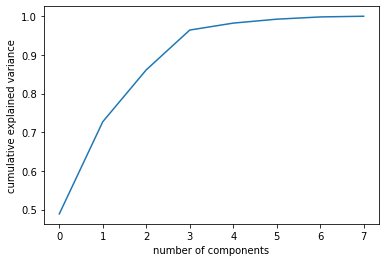

In [55]:
plt.plot(np.cumsum(pcamodel.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

In [56]:
fig = px.scatter_3d(x=pca[:, 0],
                    y=pca[:, 1],
                    z=pca[:, 2],
                    color=arr.astype("str")
                    )
fig.update_layout(
    title="PC1 vs PC2 vs PC3",
    scene=dict(xaxis=dict(title='PC1'),
               yaxis=dict(title='PC2'),
               zaxis=dict(title='PC3'),)
)

fig.show()

In [57]:
# PCA plots with 2

In [58]:
from sklearn.decomposition import PCA

pcamodel = PCA(n_components=2)
pca = pcamodel.fit_transform(X)
print(pca.shape)


# number of components
n_pcs = pcamodel.components_.shape[0]

# get the index of the most important feature of each component
most_important = [np.abs(pcamodel.components_[i]).argmax()
                  for i in range(n_pcs)]

# extract the column names frmo the dataframe
initial_feature_names = dff.columns.values

# get the names based on the principal component analysis
most_important_names = [
    initial_feature_names[most_important[i]] for i in range(n_pcs)]

# pack the result into a dataframe
dic = {'PC{}'.format(i): most_important_names[i] for i in range(n_pcs)}
df = pd.DataFrame(dic.items())

print('variance ration of each feature:', pcamodel.explained_variance_ratio_)
print('features:', most_important_names)
print(df)

(17000, 2)
variance ration of each feature: [0.48895963 0.23835794]
features: ['households', 'latitude']
     0           1
0  PC0  households
1  PC1    latitude


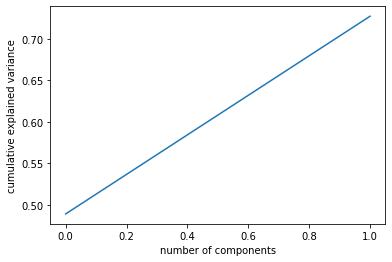

In [59]:
plt.plot(np.cumsum(pcamodel.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')


In [60]:
fig = px.scatter(x=pca[:, 0],
                 y=pca[:, 1],
                 color=arr.astype('str')
                 )
fig.update_layout(
    title="PC1 vs PC2",
    scene=dict(xaxis=dict(title='PC1'),
               yaxis=dict(title='PC2')),

)

fig.show()

In [61]:
pcamodel = PCA(n_components=3)
pca = pcamodel.fit_transform(X)
print(pca.shape)


# number of components
n_pcs = pcamodel.components_.shape[0]

# get the index of the most important feature of each component
most_important = [np.abs(pcamodel.components_[i]).argmax()
                  for i in range(n_pcs)]

# extract the column names frmo the dataframe
initial_feature_names = dff.columns.values

# get the names based on the principal component analysis
most_important_names = [
    initial_feature_names[most_important[i]] for i in range(n_pcs)]

# pack the result into a dataframe
dic = {'PC{}'.format(i): most_important_names[i] for i in range(n_pcs)}
df = pd.DataFrame(dic.items())

print('variance ration of each feature:', pcamodel.explained_variance_ratio_)
print('features:', most_important_names)
print(df)

(17000, 3)
variance ration of each feature: [0.48895963 0.23835794 0.13407398]
features: ['households', 'latitude', 'median_income']
     0              1
0  PC0     households
1  PC1       latitude
2  PC2  median_income


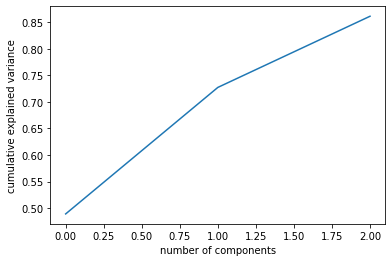

In [62]:
plt.plot(np.cumsum(pcamodel.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')


In [63]:
fig = px.scatter_3d(x=pca[:, 0],
                    y=pca[:, 1],
                    z=pca[:, 2],

                    color=arr.astype('str'))
fig.update_layout(
    title="PC1 vs PC2 vs PC3",
    scene=dict(xaxis=dict(title='PC1'),
               yaxis=dict(title='PC2'),
               zaxis=dict(title='PC3'),)
)

fig.show()

In [44]:
import plotly.express as px
from sklearn.decomposition import PCA

pcamodel = PCA(8)
components = pcamodel.fit_transform(X)
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pcamodel.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(8),
    color=arr.astype('str'))
fig.update_traces(diagonal_visible=False)
fig.show()

In [42]:
'''
Construct two tSNE plots with 2 and 3 components. Experiment with different parameter values
(perplexity, number of iterations, etc.). Show these plots. Use “from sklearn.manifold import TSNE”
library for tSNE
'''

'\nConstruct two tSNE plots with 2 and 3 components. Experiment with different parameter values\n(perplexity, number of iterations, etc.). Show these plots. Use “from sklearn.manifold import TSNE”\nlibrary for tSNE\n'

In [ ]:
tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=50, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=60, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=70, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=5, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=10, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=20, n_iter=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=20, n_iter=1000,
            early_exaggeration=24, learning_rate=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



In [ ]:
tsne = TSNE(n_components=2, perplexity=20, n_iter=1000,
            early_exaggeration=36, learning_rate=500, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter(
    projections, x=0, y=1,
    color=arr.astype('str'))
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



In [ ]:
tsne = TSNE(n_components=3, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=arr.astype('str')
)
fig.update_traces(marker_size=8)
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
tsne = TSNE(n_components=3, perplexity=20, n_iter=1000,
            early_exaggeration=24, learning_rate=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,

    color=arr.astype('str')
)
fig.update_traces(marker_size=8)
fig.show()


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



In [ ]:
tsne = TSNE(n_components=3, perplexity=20, n_iter=1000,
            early_exaggeration=12, learning_rate=1000, random_state=0)
projections = tsne.fit_transform(X)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=arr.astype('str')
)
fig.update_traces(marker_size=8)
fig.show()

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



In [65]:


distortions = []
K = range(1, 12)

for cluster_size in K:
    kmeans = cluster.KMeans(n_clusters=cluster_size, init='k-means++')
    kmeans = kmeans.fit(X)
    distortions.append(kmeans.inertia_)

df = pd.DataFrame({'Clusters': K, 'Distortions': distortions})
fig = (px.line(df, x='Clusters', y='Distortions', template='seaborn')
       ).update_traces(mode='lines+markers')
fig.show()

In [66]:
import sklearn.metrics as metrics
silhouette_scores = []
K = range(2, 12)

for cluster_size in K:
    kmeans = cluster.KMeans(n_clusters=cluster_size,
                            init='k-means++', random_state=200)
    labels = kmeans.fit(X).labels_
    silhouette_score = metrics.silhouette_score(X,
                                                labels,
                                                metric='euclidean',
                                                sample_size=1000,
                                                random_state=200)

    silhouette_scores.append(silhouette_score)

df = pd.DataFrame({'Clusters': K, 'Silhouette Score': silhouette_scores})
fig = (px.line(df, x='Clusters', y='Silhouette Score',
       template='seaborn')).update_traces(mode='lines+markers')
fig.show()

In [67]:
kmeans = KMeans(n_clusters=2, init="k-means++",
                max_iter=500, n_init=10, random_state=123)
identified_clusters = kmeans.fit_predict(X)
data_with_clusters = dff.copy()
data_with_clusters['Cluster'] = identified_clusters

In [68]:
fig = px.scatter(data_with_clusters, x='total_rooms', y='total_bedrooms',
                 color='Cluster', opacity=0.8)

fig.show()

In [69]:
fig = px.scatter(data_with_clusters, x='longitude', y='total_bedrooms',
                 color='Cluster', opacity=0.8)

fig.show()

In [70]:
fig = px.scatter(data_with_clusters, x='population', y='median_income',
                 color='Cluster', opacity=0.8)

fig.show()

In [71]:
fig = px.scatter_3d(data_with_clusters, x='longitude', y='total_bedrooms', z='housing_median_age',
                    color='Cluster', opacity=0.8)
fig.show()

In [72]:

fig = px.scatter_3d(data_with_clusters, x='population', y='total_bedrooms', z='median_income',
                    color='Cluster', opacity=0.8)
fig.show()

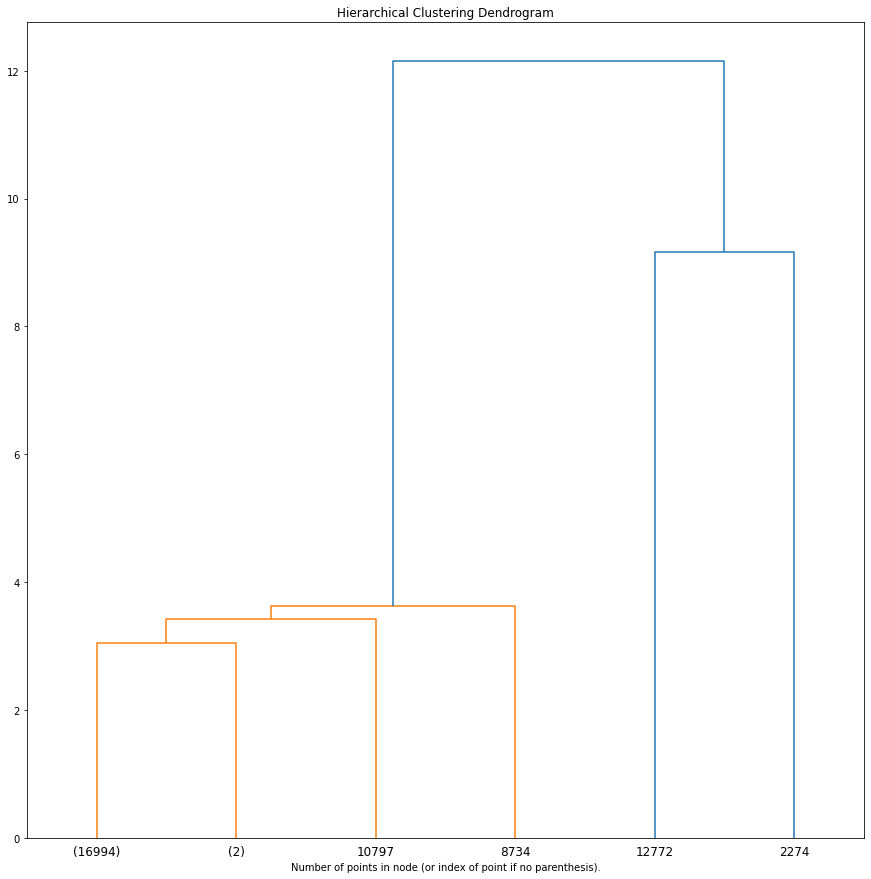

In [253]:


def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(
    distance_threshold=0, n_clusters=None, linkage='single')

model = model.fit(X)
plt.figure(figsize=(15, 15))
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

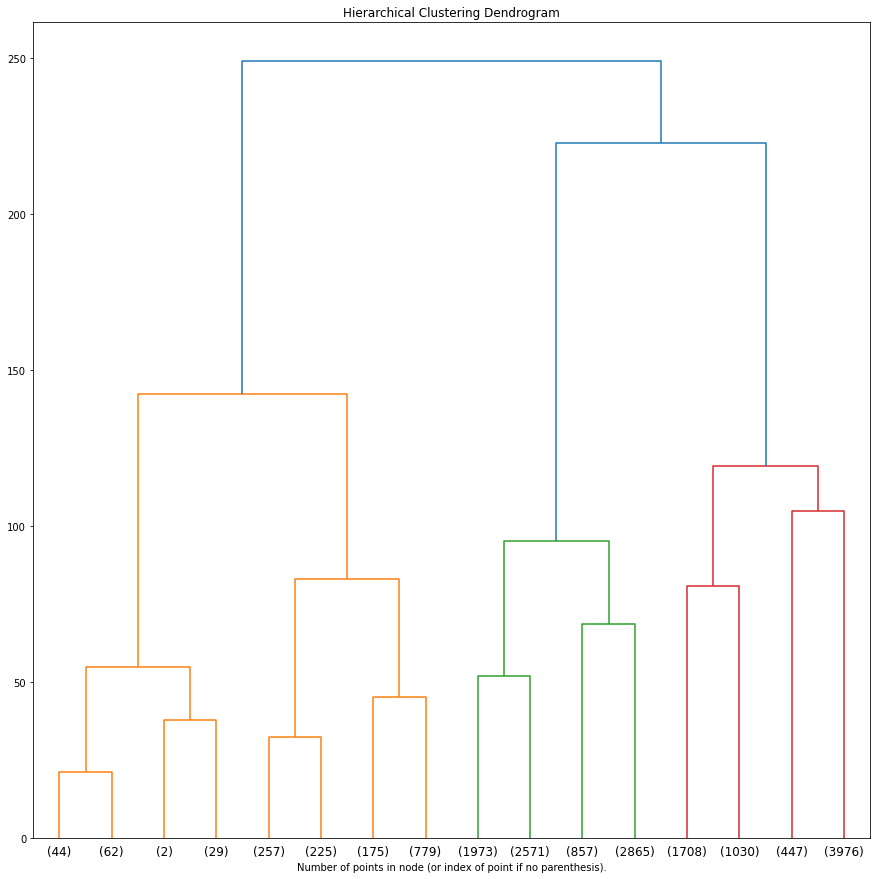

In [254]:


def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(
    distance_threshold=0, n_clusters=None, linkage='ward')
plt.figure(figsize=(15, 15))
model = model.fit(X)
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

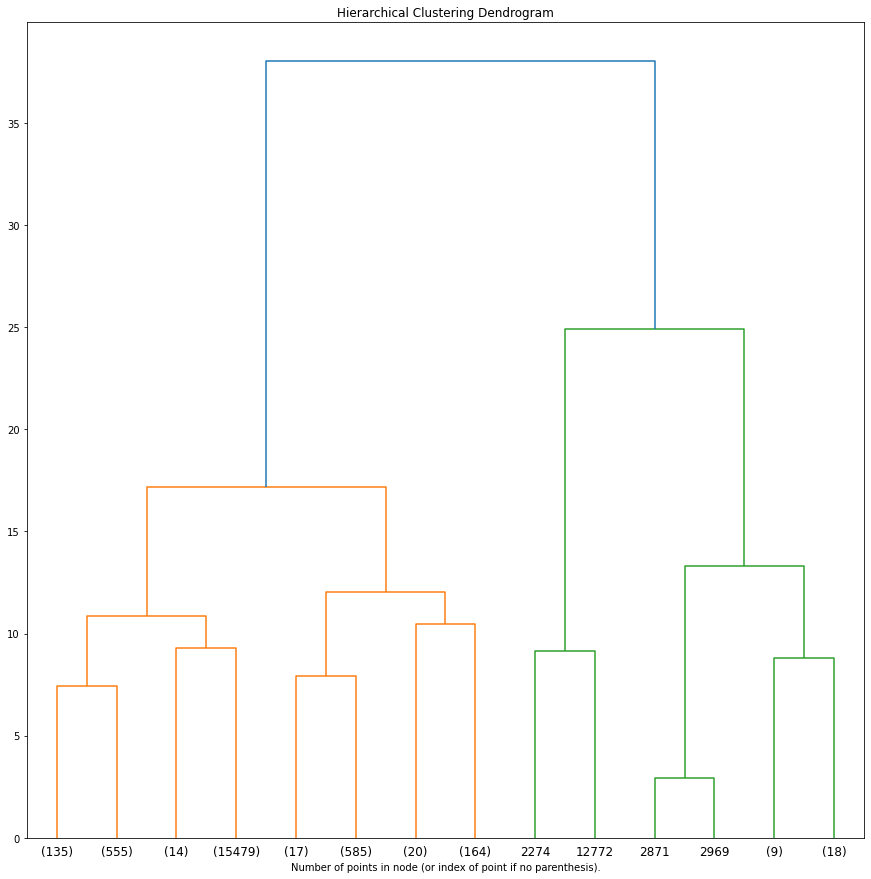

In [255]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(
    distance_threshold=0, n_clusters=None, linkage='complete')

model = model.fit(X)
plt.figure(figsize=(15, 15))
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [75]:

neigh = NearestNeighbors()
nbrs = neigh.fit(X)
distances, indices = nbrs.kneighbors(X)

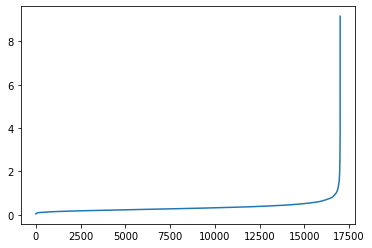

In [76]:
distances = np.sort(distances, axis=0)
distances = distances[:, 1]
plt.plot(distances)

In [233]:
def dbscan(X, eps, min_samples):
    db = DBSCAN(eps=eps, min_samples=min_samples)
    db.fit(X)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of noise points: %d" % n_noise_)
    print("Silhouette Coefficient: %0.3f" %
          metrics.silhouette_score(X, labels))
    y_pred = db.fit_predict(X)
    fig, axs = plt.subplots(8, 8, figsize=(15, 15))

    for i in range(0, 8):
        for j in range(0, 8):

            axs[i, j].scatter(X[:, i], X[:, j], c=y_pred, cmap='Paired')

    plt.title("DBSCAN")

Estimated number of clusters: 5
Estimated number of noise points: 9364
Silhouette Coefficient: -0.131


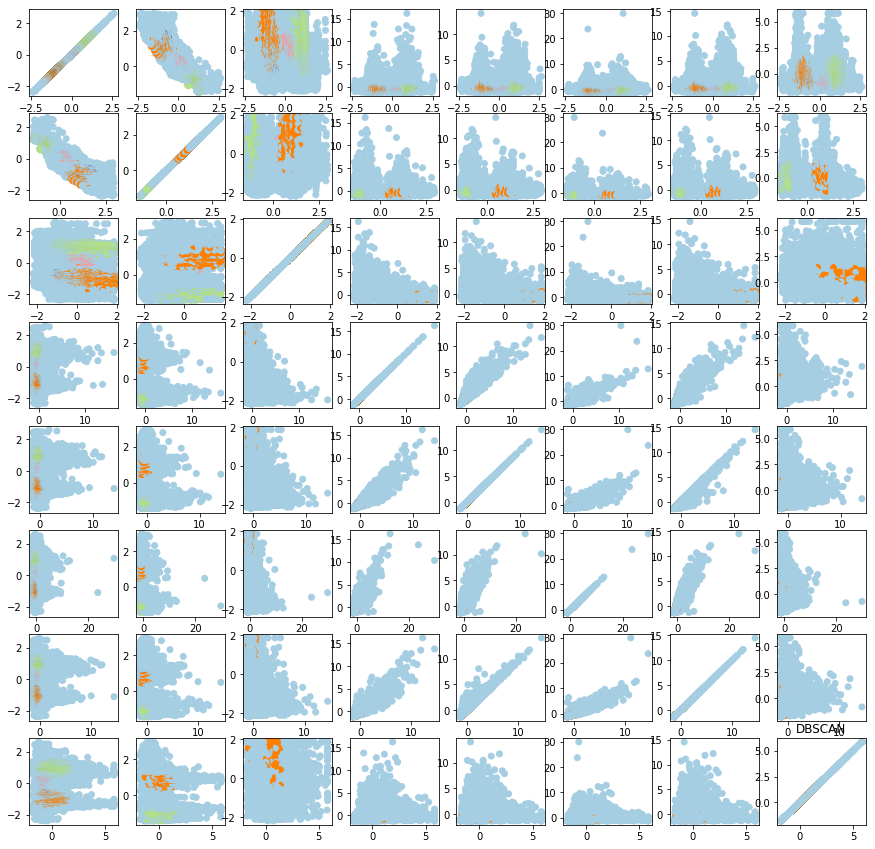

In [234]:
dbscan(X, 0.5, 30)

Estimated number of clusters: 2
Estimated number of noise points: 13314
Silhouette Coefficient: -0.088


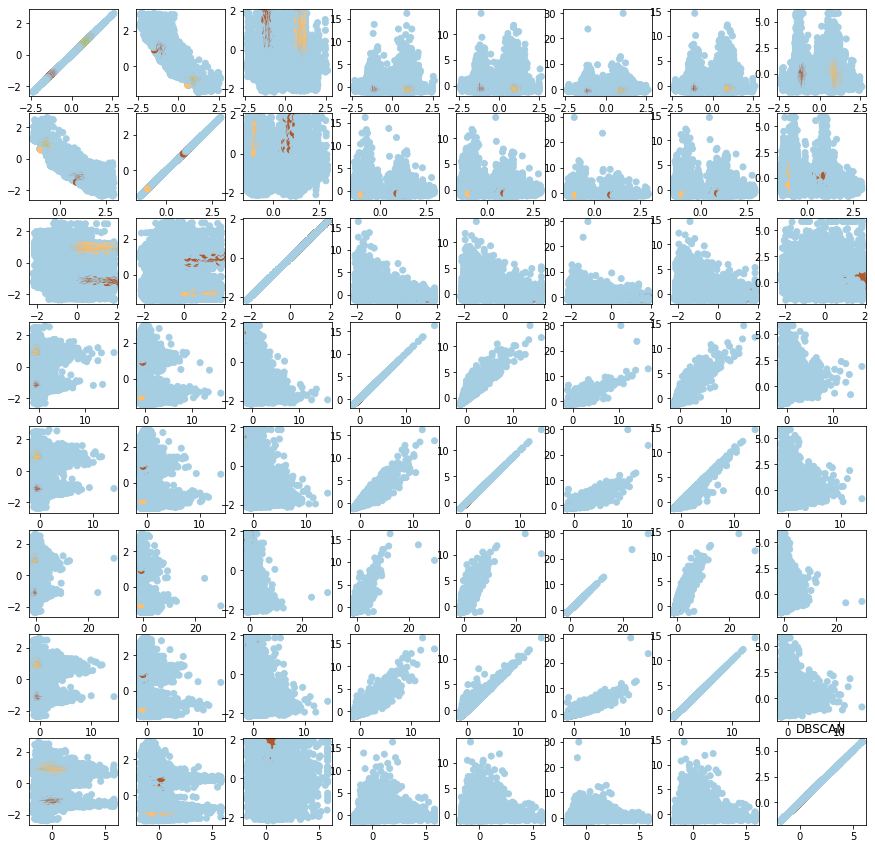

In [235]:
dbscan(X, 0.4, 30)

Estimated number of clusters: 1
Estimated number of noise points: 945
Silhouette Coefficient: 0.524


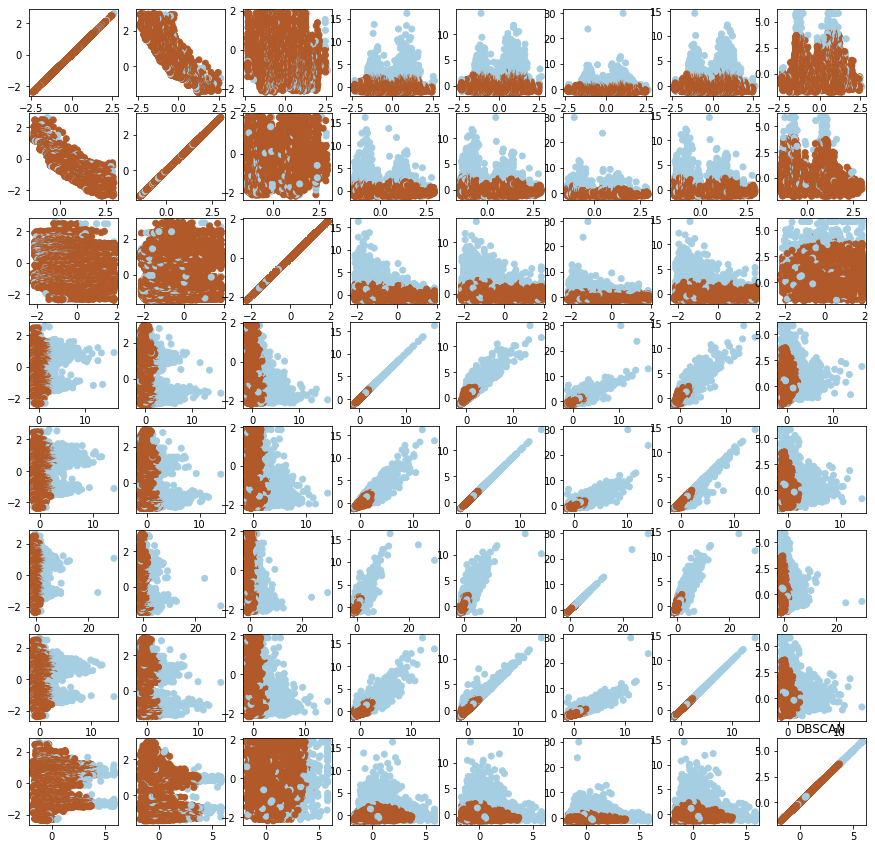

In [236]:
dbscan(X, 1, 30)

Estimated number of clusters: 1
Estimated number of noise points: 269
Silhouette Coefficient: 0.658


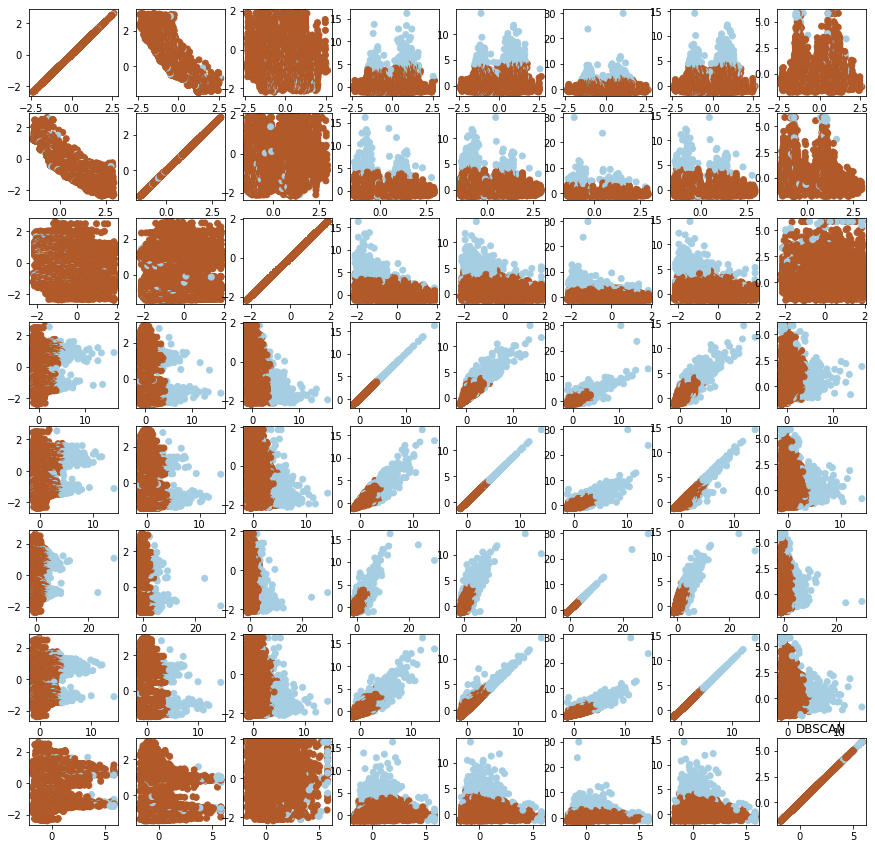

In [237]:
dbscan(X, 1.5, 30)

Estimated number of clusters: 1
Estimated number of noise points: 97
Silhouette Coefficient: 0.730


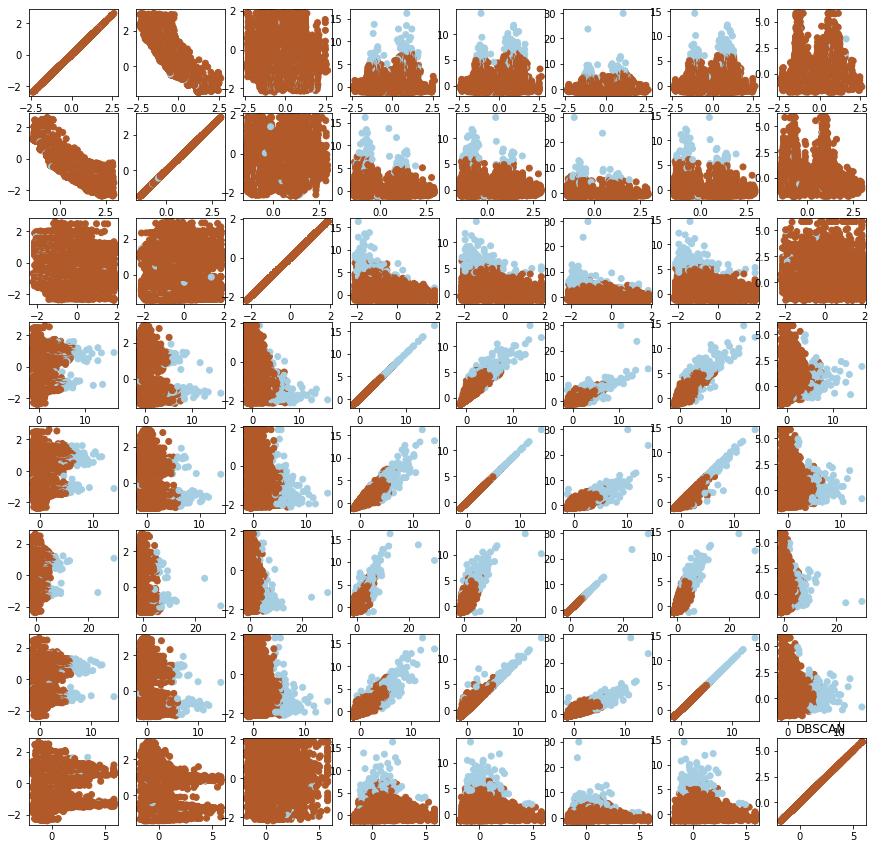

In [238]:
dbscan(X, 2, 30)

Estimated number of clusters: 1
Estimated number of noise points: 28
Silhouette Coefficient: 0.801


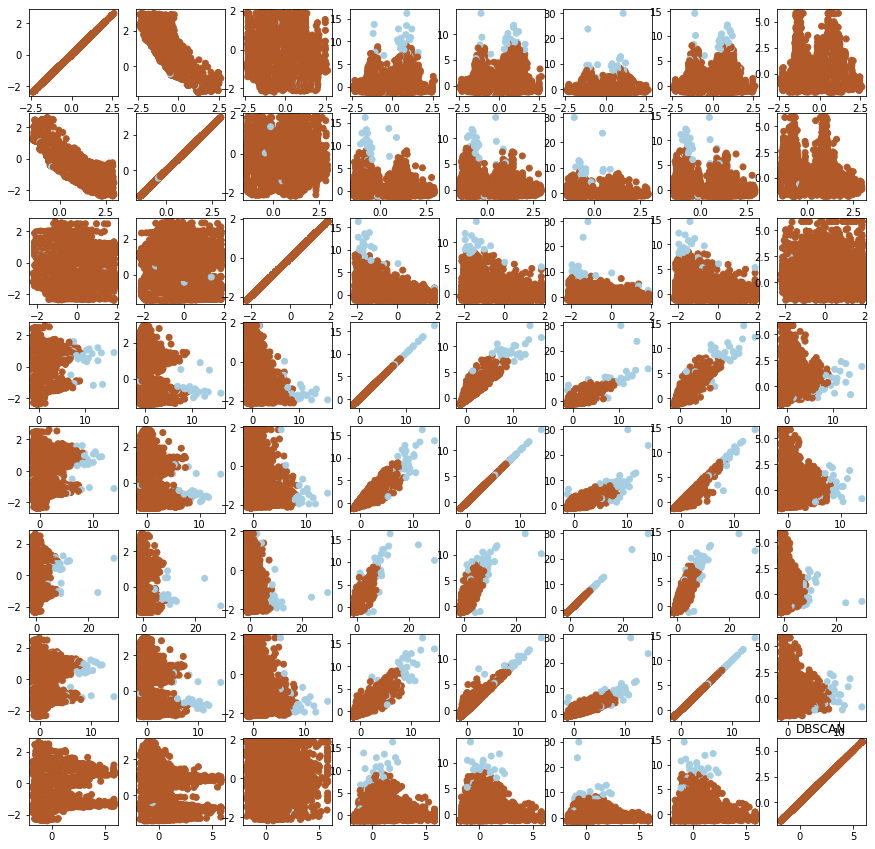

In [242]:
dbscan(X, 3, 20)

In [131]:
def plot_variance(pca, width=8, dpi=100):
    # Create figure
    fig, axs = plt.subplots(1, 2)
    n = pca.n_components_
    grid = np.arange(1, n + 1)
    # Explained variance
    evr = pca.explained_variance_ratio_
    axs[0].bar(grid, evr)
    axs[0].set(
        xlabel="Component", title="% Explained Variance", ylim=(0.0, 1.0)
    )
    # Cumulative Variance
    cv = np.cumsum(evr)
    axs[1].plot(np.r_[0, grid], np.r_[0, cv], "o-")
    axs[1].set(
        xlabel="Component", title="% Cumulative Variance", ylim=(0.0, 1.0)
    )
    # Set up figure
    fig.set(figwidth=8, dpi=100)
    return axs

In [137]:
def make_mi_scores(X, y, discrete_features):
    from sklearn.feature_selection import mutual_info_regression
    mi_scores = mutual_info_regression(
        X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

In [128]:
X_ = dff.loc[:, dff.columns != 'median_house_value']
y = dff.loc[:, dff.columns == 'median_house_value']

In [156]:
pca = PCA()
X_pca = pca.fit_transform(X)

# Convert to dataframe
component_names = [f"PC{i+1}" for i in range(X_pca.shape[1])]
X_pca = pd.DataFrame(X_pca, columns=component_names)

X_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
0,1.756371,-2.081541,-0.881396,-1.337153,-1.651622,1.242562,-0.332564,0.885733
1,2.886282,-1.789440,-0.933482,-0.783609,-2.406858,1.467919,-0.202815,1.819250
2,-1.375555,-2.577270,-0.613384,-1.696212,-0.306253,0.738101,-0.520207,-0.069170
3,-0.711540,-2.548927,0.141960,-1.472921,-0.416032,0.671038,-0.610399,0.008683
4,-0.773053,-2.532118,-0.656955,-1.300842,-0.384212,0.709077,-0.535324,-0.080249


In [157]:
loadings = pd.DataFrame(
    pca.components_.T,  # transpose the matrix of loadings
    columns=component_names,  # so the columns are the principal components
    index=X_.columns,  # and the rows are the original features
)
loadings

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
longitude,0.079041,-0.700802,-0.058452,-0.066424,-0.105109,0.472613,-0.507381,-0.054346
latitude,-0.076311,0.701332,0.014215,-0.102820,-0.054976,0.457435,-0.526804,-0.041754
housing_median_age,-0.218167,0.020735,-0.389670,0.888099,-0.036098,0.091261,-0.041970,0.004252
total_rooms,0.483167,0.077470,0.097531,0.115355,-0.308653,0.568117,0.549381,-0.133735
total_bedrooms,0.490221,0.063483,-0.115475,0.063584,-0.378724,-0.240970,-0.226952,0.696614
population,0.472434,0.029773,-0.114828,0.084143,0.849253,0.125813,-0.038078,0.130935
households,0.491560,0.065791,-0.107431,0.097015,-0.147410,-0.398282,-0.281363,-0.688160
median_income,0.041708,-0.036508,0.892729,0.403057,0.054465,-0.061487,-0.171285,0.037709


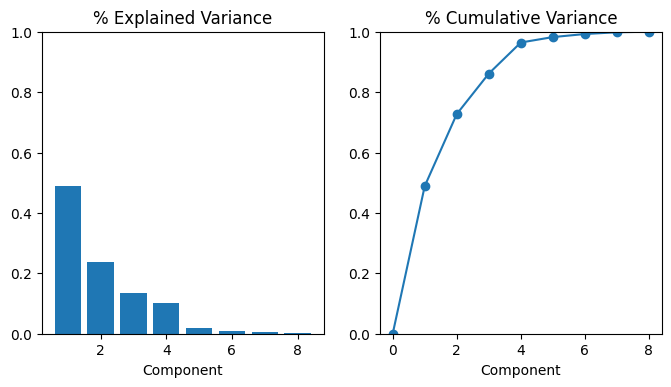

In [158]:
plot_variance(pca)

In [159]:
mi_scores = make_mi_scores(X_pca, y, discrete_features=False)
mi_scores

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



PC3    0.214079
PC2    0.133932
PC4    0.130903
PC6    0.121315
PC7    0.058298
PC5    0.037263
PC8    0.026638
PC1    0.015977
Name: MI Scores, dtype: float64

In [195]:
steps = [('pca', PCA(n_components=4)), ('m',  KMeans(n_clusters=2,
                                                     init="k-means++", max_iter=500, n_init=10, random_state=123))]
model = Pipeline(steps=steps)
model.fit_predict(X)
data_with_clusters = dff.copy()
data_with_clusters['Cluster'] = model['m'].labels_

fig = px.scatter_matrix(
    data_with_clusters,
    color='Cluster'
)
fig.update_traces(diagonal_visible=False)
fig.show()


In [243]:
steps = [('pca', PCA(n_components=4)), ('m',  DBSCAN(eps=2, min_samples=30))]
model = Pipeline(steps=steps)
model.fit_predict(X)
data_with_clusters = dff.copy()
data_with_clusters['Cluster'] = model['m'].labels_

fig = px.scatter_matrix(
    data_with_clusters,
    color='Cluster'
)
fig.update_traces(diagonal_visible=False)
fig.show()


In [256]:
steps = [('pca', PCA(n_components=4)), ('m',  AgglomerativeClustering(
    distance_threshold=0, n_clusters=None))]
model = Pipeline(steps=steps)
model.fit_predict(X)
data_with_clusters = dff.copy()
data_with_clusters['Cluster'] = model['m'].labels_

fig = px.scatter_matrix(
    data_with_clusters,
    color='Cluster'
)
fig.update_traces(diagonal_visible=False)
fig.show()
